In [ ]:
import os
import time
import random
import matplotlib.pyplot as plt

import tensorflow as tf
from tensorflow.keras.models import Model, load_model



In [ ]:
def generate_random_image(shape = (96, 96 , 3), seed = None):
    return tf.random.uniform(shape = shape, minval = 0, maxval = 1, dtype= tf.dtypes.float32, seed = seed)

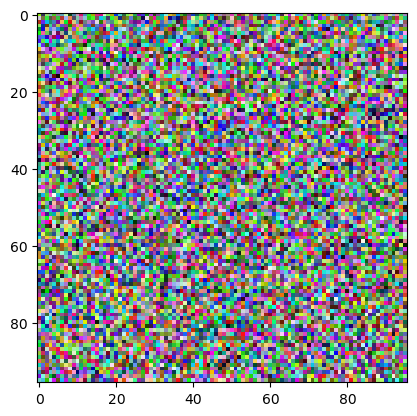

In [ ]:
img = generate_random_image()
plt.imshow(img)

In [ ]:
def create_submodel(model = None, layer_name = None, verbose = True):
    submodel = Model(inputs = model.input, outputs = model.get_layer(layer_name).output)
    if verbose:
        submodel.summary()
        
    return submodel

In [ ]:
from tensorflow.keras.applications import VGG19

vgg19 = VGG19(input_shape= (96, 96, 3), include_top= False, weights = 'imagenet')
submodel = create_submodel(vgg19, 'block1_conv2', verbose = True)

Model: "model_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 96, 96, 3)]       0         
                                                                 
 block1_conv1 (Conv2D)       (None, 96, 96, 64)        1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 96, 96, 64)        36928     
                                                                 
Total params: 38,720
Trainable params: 38,720
Non-trainable params: 0
_________________________________________________________________


In [ ]:
def normalize_tensor(tensor):
    min_val = tf.reduce_min(tensor)
    max_val = tf.reduce_max(tensor)
    normalized_tensor = tf.math.divide(tf.subtract(tensor, min_val), tf.subtract(max_val, min_val))
    return normalized_tensor


In [ ]:
def train_filter(input_img, model, filter_index = None, epochs = 30, step = 10, verbose = False, log_rate = 0.2):
    losses = []
    for i in range(epochs):
        
        with tf.GradientTape() as tape:
            loss = 0
            tape.watch(input_img)
            output = model(tf.expand_dims(input_img, axis = 0))[:,:,:, filter_index]
            loss = tf.math.reduce_mean(output)
            
            if verbose:
                if i % int(epochs * log_rate) == 0:
                    losses.append(float(loss))
                    print(f'EPOCH {i} LOSS : {float(loss)}')
            
        grads = tape.gradient(loss, input_img)
        grads = tf.math.l2_normalize(grads)
        input_img += grads * step
        
        input_img = normalize_tensor(input_img)
    
    return input_img, losses


EPOCH 0 LOSS : 1.0535107851028442
EPOCH 20 LOSS : 2.789926767349243
EPOCH 40 LOSS : 2.850693702697754
EPOCH 60 LOSS : 2.858334541320801
EPOCH 80 LOSS : 2.8568344116210938
0.5998940467834473


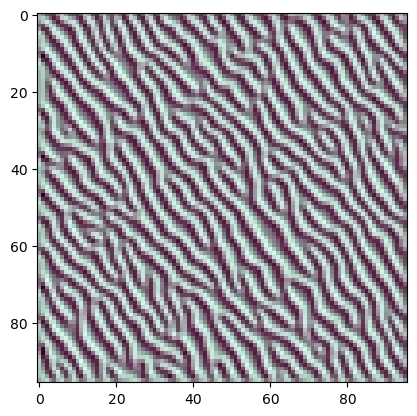

In [ ]:
beg = time.time()
newimg,_ = train_filter(img, submodel, 5,epochs = 100, verbose = True)
print(time.time() - beg)
newimg = tf.cast(255 * newimg, dtype=tf.int32).numpy()


plt.imshow(newimg)

In [ ]:
def check_and_create_directory(path):
    if not os.path.exists(path):
        os.makedirs(path)
        print(f"Directory created: {path}")
    elif not os.path.isdir(path):
        print(f"Error: {path} is not a directory.")
    else:
        print(f"Directory already exists: {path}")

In [ ]:
def visualize_filters_in_layer(input_img, submodel, layer_name, n_filters = -1, 
                               epochs = 30, step = 10, fig_size = (10,10), save_dir = os.getcwd()):

    total_layer_filters = submodel.output_shape[-1]
    if n_filters == -1:
        n_filters = total_layer_filters 
    
    print(f'Processing {n_filters} filters in {layer_name} layer')

    if n_filters <= 4:
        rows = 1
    elif n_filters <= 8:
        rows = 2
    elif n_filters <= 32:
        rows = 4
    else:
        rows = 8
    
    cols = n_filters // rows
    #print(n_filters)
    #print(cols)
    fig = plt.figure(figsize = fig_size )
    
    if n_filters == total_layer_filters:
        for filter_idx in range(n_filters):      
            filter,_  = train_filter(input_img, submodel, filter_index = filter_idx, 
                                        epochs = 30, step = 10, verbose = False)
            fig.add_subplot(rows, cols, filter_idx + 1)
            plt.subplots_adjust(hspace=0.6)
            plt.imshow(filter)
            plt.axis('off')
            plt.title(str(filter_idx), pad = 10)
    else:
        random_filter_idxs = sorted([random.randint(0, total_layer_filters-1) for _ in range(n_filters)])
        #print(random_filter_idxs)
        for i, filter_idx in enumerate(random_filter_idxs):      
            filter,_  = train_filter(input_img, submodel, filter_index = filter_idx, 
                                        epochs = 30, step = 10, verbose = False)
        
            fig.add_subplot(rows, cols, i + 1)
            #plt.subplots_adjust(hspace=0.6)
            plt.imshow(filter)
            plt.axis('off')
            plt.title(str(filter_idx), pad = 1)

    
    # Set the figure title
    fig.suptitle(f'{layer_name} filters ( {n_filters} / {total_layer_filters})')
    
    check_and_create_directory(save_dir)
    save_file = os.path.join('.',save_dir, f'{layer_name} filters.png')
    # Save the figure to a file
    plt.savefig(save_file)  # Save as PNG format

Processing 16 filters in block1_conv2 layer
Directory already exists: /kaggle/working


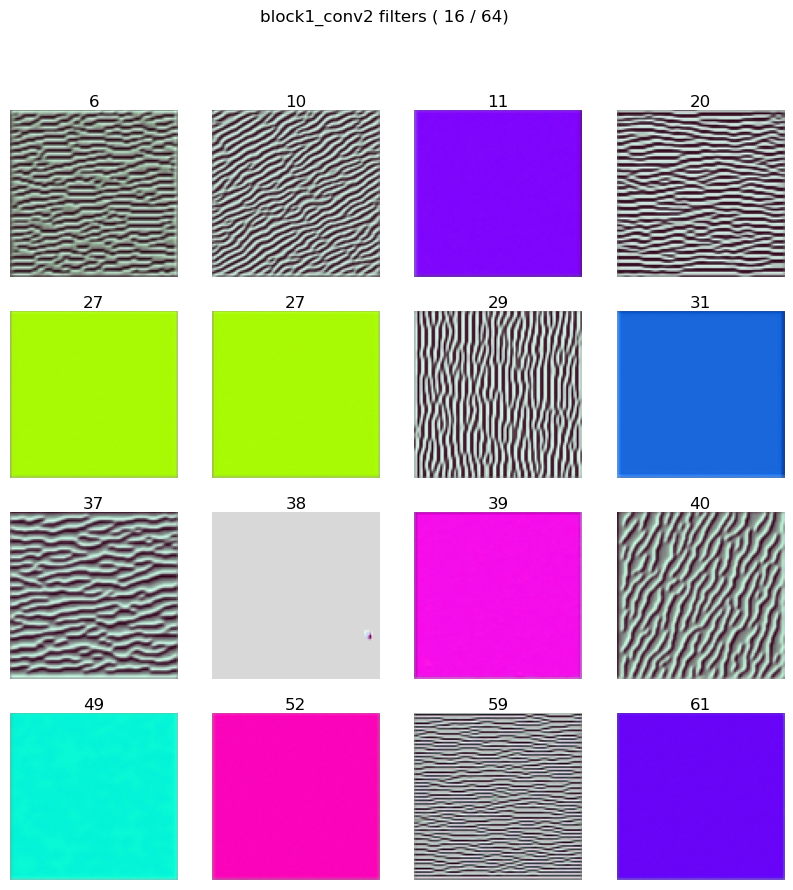

In [ ]:
visualize_filters_in_layer(input_img = img, submodel = submodel, 
                       layer_name = 'block1_conv2', n_filters = 16, epochs = 30, 
                       step = 10, fig_size = (10,10))

In [ ]:
def save_all_filters(input_img, model, layer_names =[], n_filters = 16, 
                     epochs = 30, step = 10, fig_size = (10,10), save_dir = os.getcwd()):

    for layer_name in layer_names:

        submodel = create_submodel(model, layer_name, verbose = False)

        visualize_filters_in_layer(input_img, submodel, 
                       layer_name, n_filters = n_filters, epochs = 30, 
                       step = 10, fig_size = (10,10), save_dir = save_dir)
        



['block1_conv1', 'block1_conv2', 'block2_conv1', 'block2_conv2', 'block3_conv1', 'block3_conv2', 'block3_conv3', 'block3_conv4', 'block4_conv1', 'block4_conv2', 'block4_conv3', 'block4_conv4', 'block5_conv1', 'block5_conv2', 'block5_conv3', 'block5_conv4']
Processing 16 filters in block1_conv1 layer
Directory created: VGG19
Processing 16 filters in block1_conv2 layer
Directory already exists: VGG19
Processing 16 filters in block2_conv1 layer
Directory already exists: VGG19
Processing 16 filters in block2_conv2 layer
Directory already exists: VGG19
Processing 16 filters in block3_conv1 layer
Directory already exists: VGG19
Processing 16 filters in block3_conv2 layer
Directory already exists: VGG19
Processing 16 filters in block3_conv3 layer
Directory already exists: VGG19
Processing 16 filters in block3_conv4 layer
Directory already exists: VGG19
Processing 16 filters in block4_conv1 layer
Directory already exists: VGG19
Processing 16 filters in block4_conv2 layer
Directory already exis

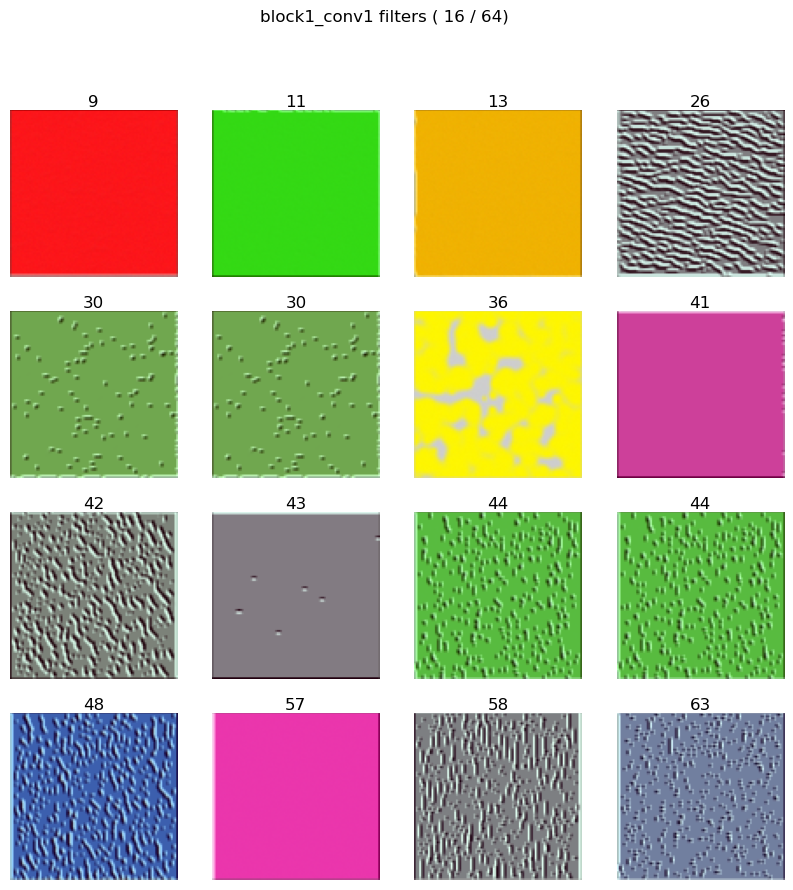

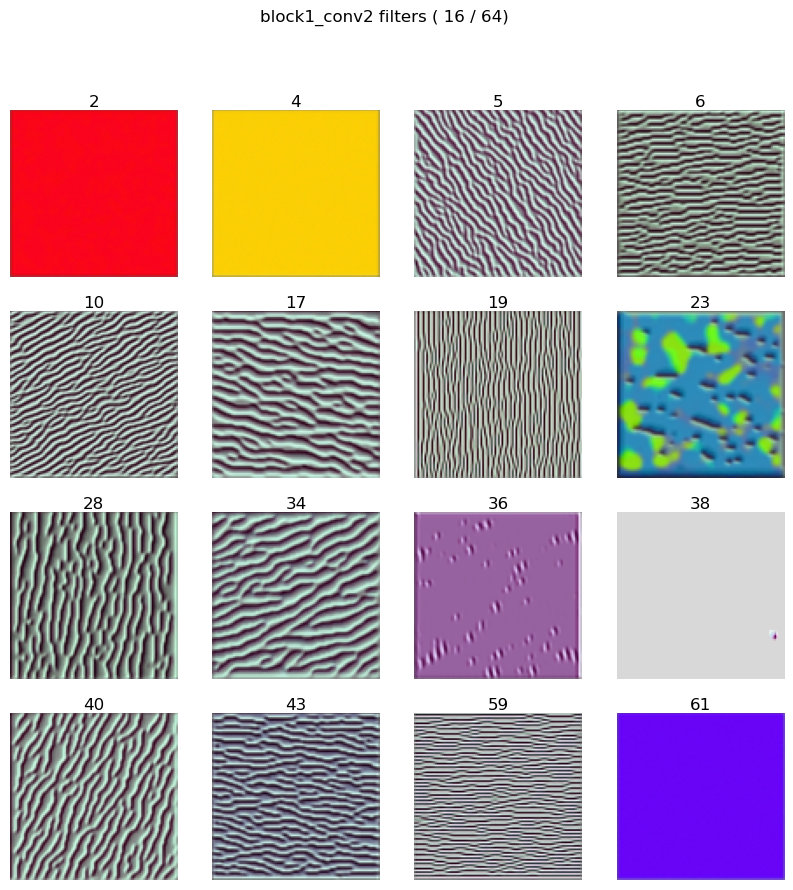

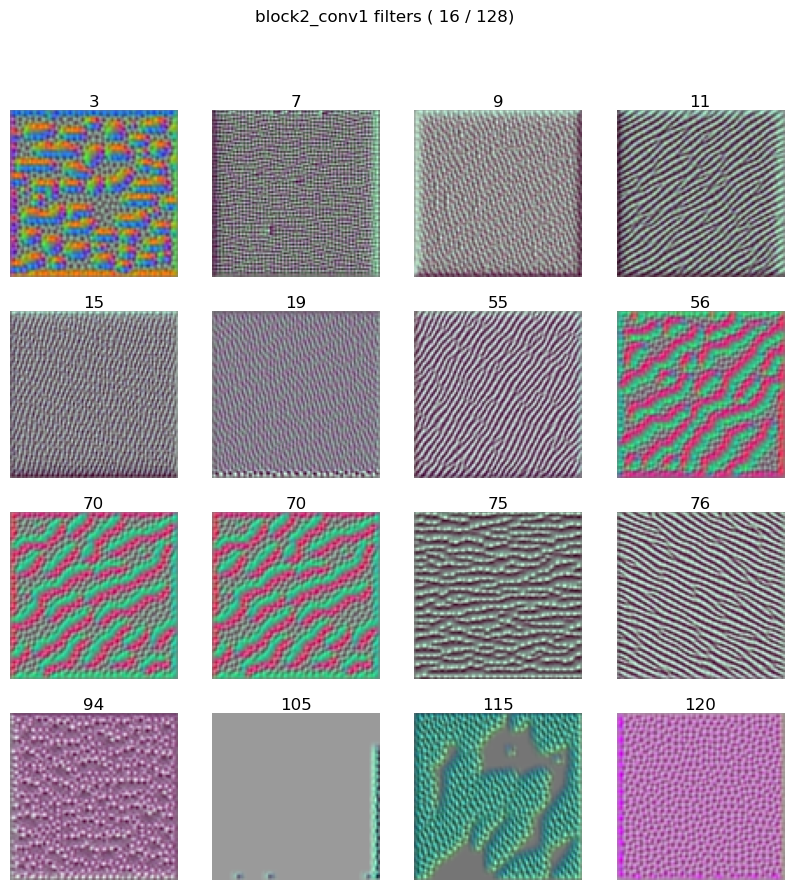

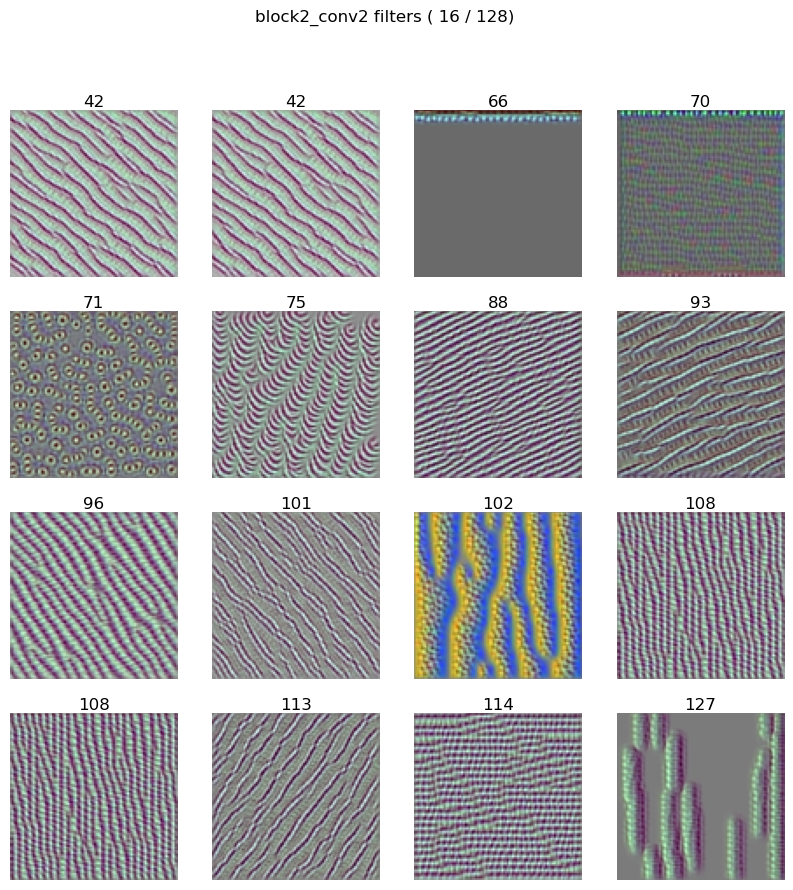

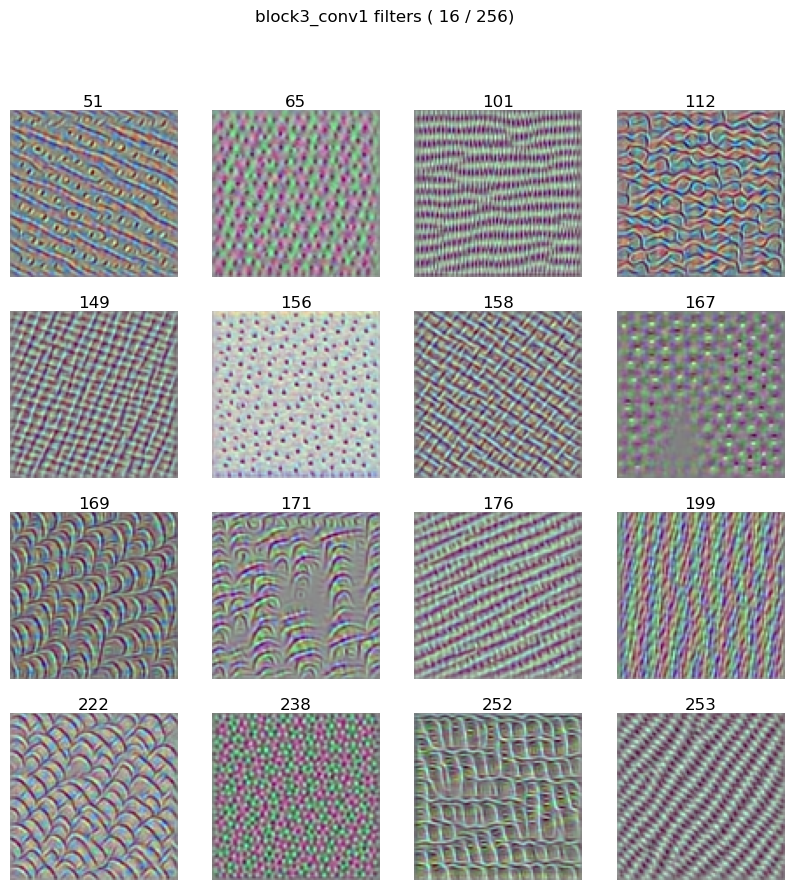

...

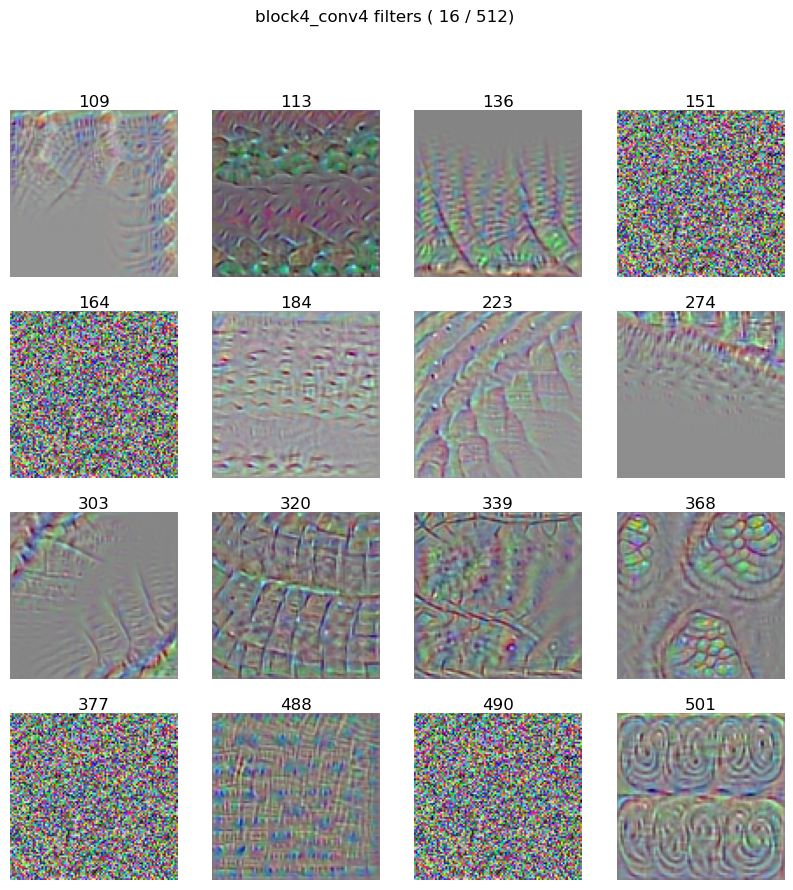

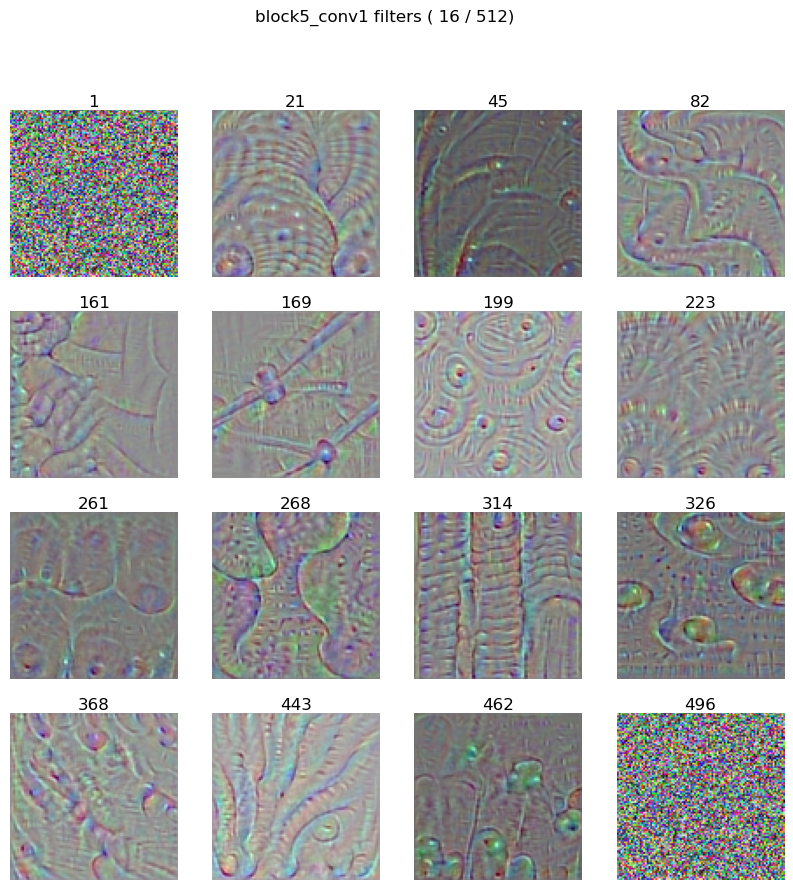

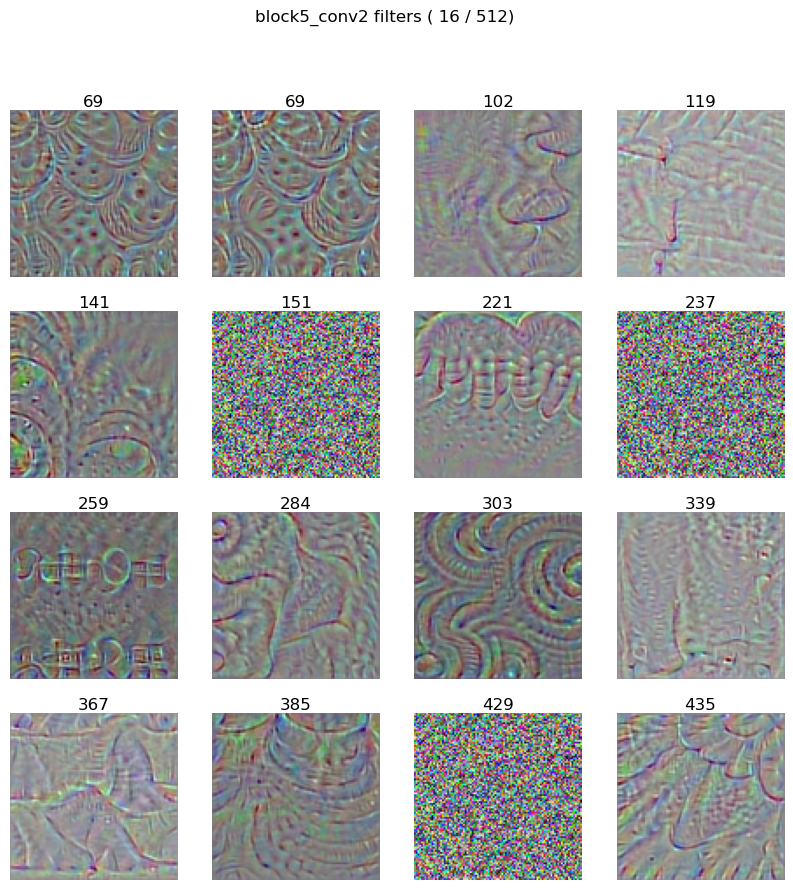

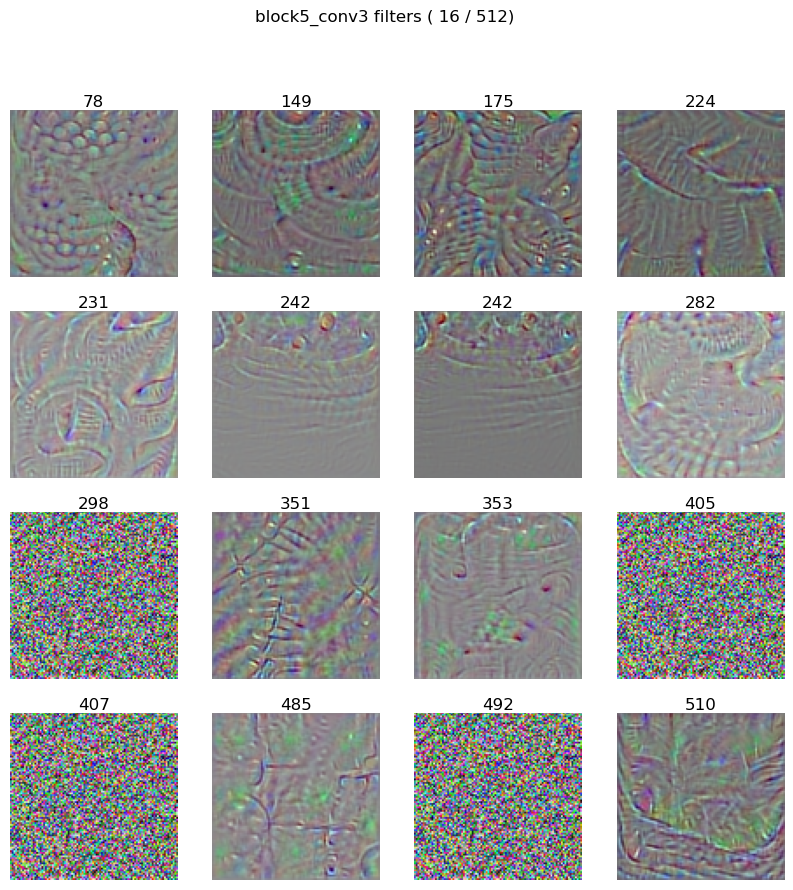

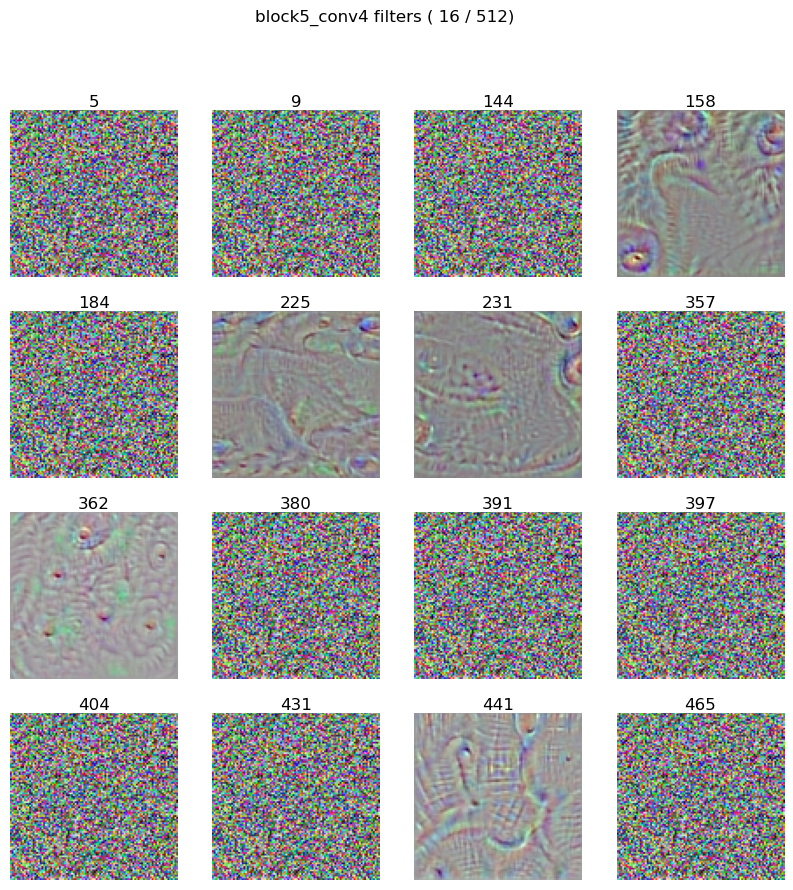

In [ ]:
layer_names = [layer.name for layer in vgg19.layers if 'conv' in layer.name]
print(layer_names)
save_all_filters(input_img = img, layer_names = layer_names, 
                 model = vgg19, n_filters = 16, 
                 epochs = 30, step = 10, save_dir = 'VGG19'
                 )

In [ ]:
!git clone https://github.com/mohamedamine99/Visualizing-what-convnets-learn.git

Cloning into 'Visualizing-what-convnets-learn'...
remote: Enumerating objects: 2378, done.
remote: Counting objects: 100% (352/352), done.
remote: Compressing objects: 100% (266/266), done.
remote: Total 2378 (delta 108), reused 303 (delta 78), pack-reused 2026
Receiving objects: 100% (2378/2378), 619.23 MiB | 26.07 MiB/s, done.
Resolving deltas: 100% (111/111), done.
Updating files: 100% (2193/2193), done.


In [ ]:
cnn_model = load_model('./Visualizing-what-convnets-learn/models/CNN cats vs dogs model.hdf5')
cnn_model.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_3 (Conv2D)           (None, 126, 126, 32)      896       
                                                                 
 batch_normalization_4 (Batc  (None, 126, 126, 32)     128       
 hNormalization)                                                 
                                                                 
 max_pooling2d_3 (MaxPooling  (None, 63, 63, 32)       0         
 2D)                                                             
                                                                 
 dropout_4 (Dropout)         (None, 63, 63, 32)        0         
                                                                 
 conv2d_4 (Conv2D)           (None, 61, 61, 64)        18496     
                                                                 
 batch_normalization_5 (Batc  (None, 61, 61, 64)      

In [ ]:
print(cnn_model.input_shape)
print(cnn_model.input_shape[1:])

(None, 128, 128, 3)
(128, 128, 3)


['conv2d_3', 'conv2d_4', 'conv2d_5', 'conv2d_6']
Processing 16 filters in conv2d_3 layer
Directory created: CNN
Processing 16 filters in conv2d_4 layer
Directory already exists: CNN
Processing 16 filters in conv2d_5 layer
Directory already exists: CNN
Processing 16 filters in conv2d_6 layer
Directory already exists: CNN


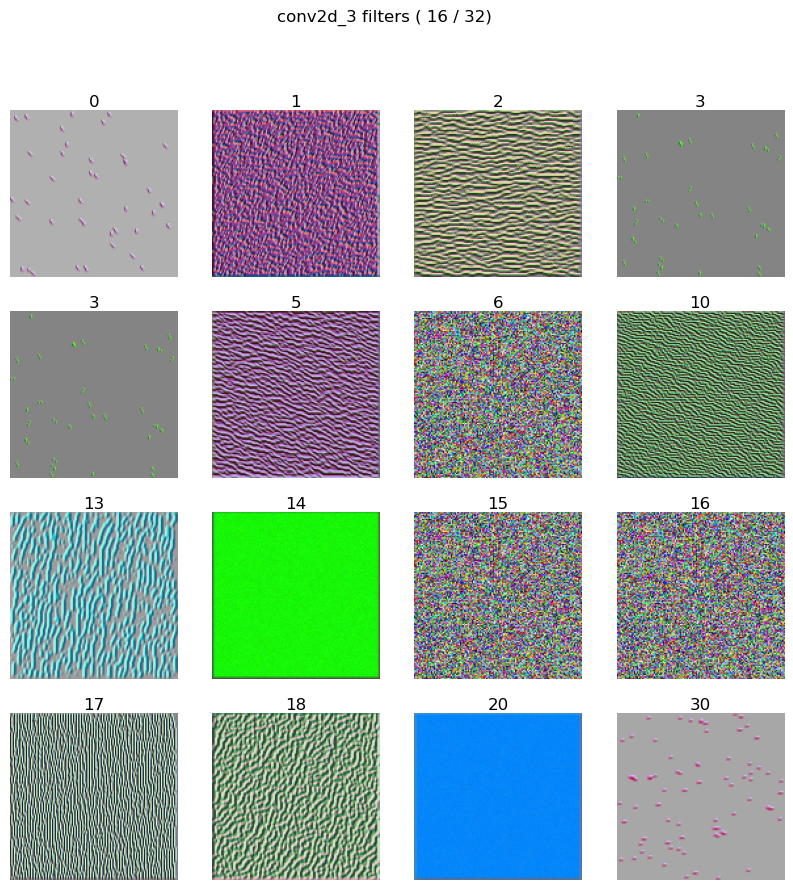

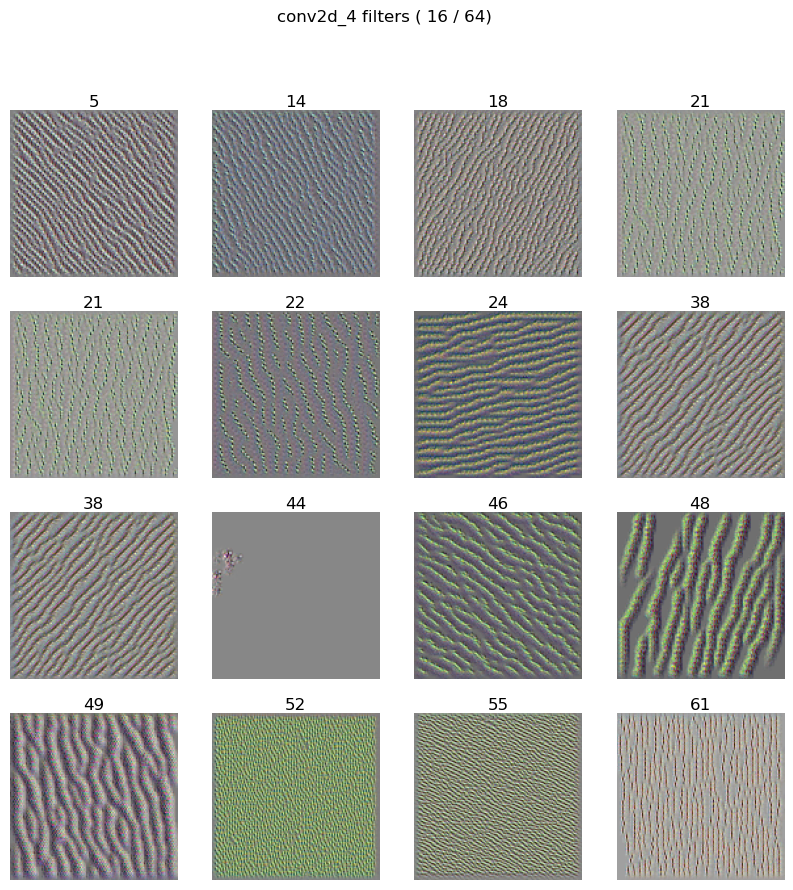

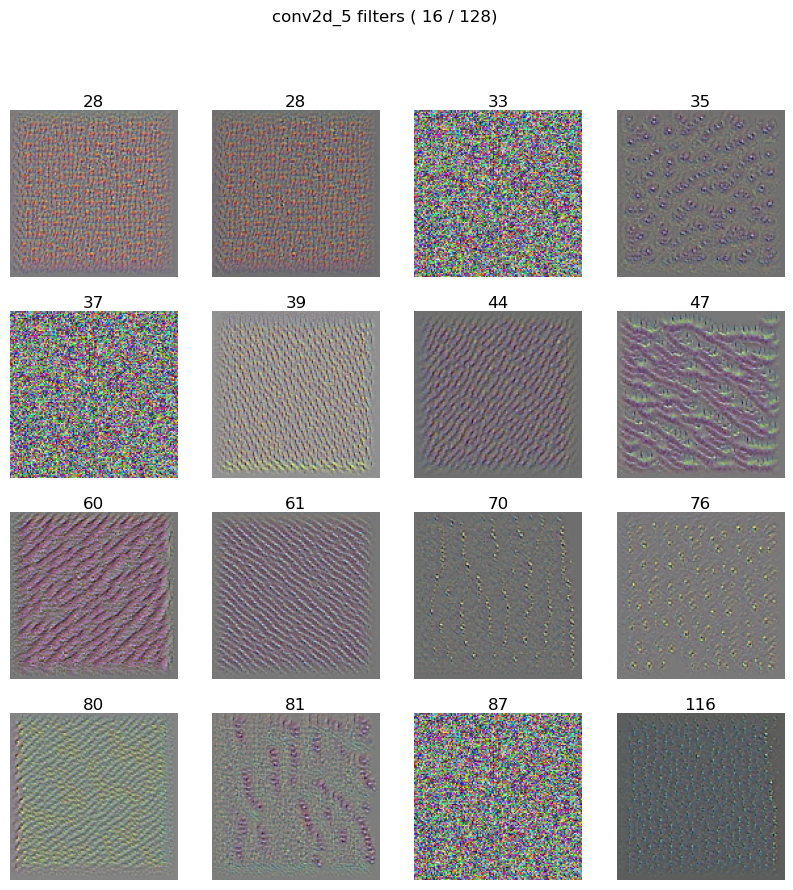

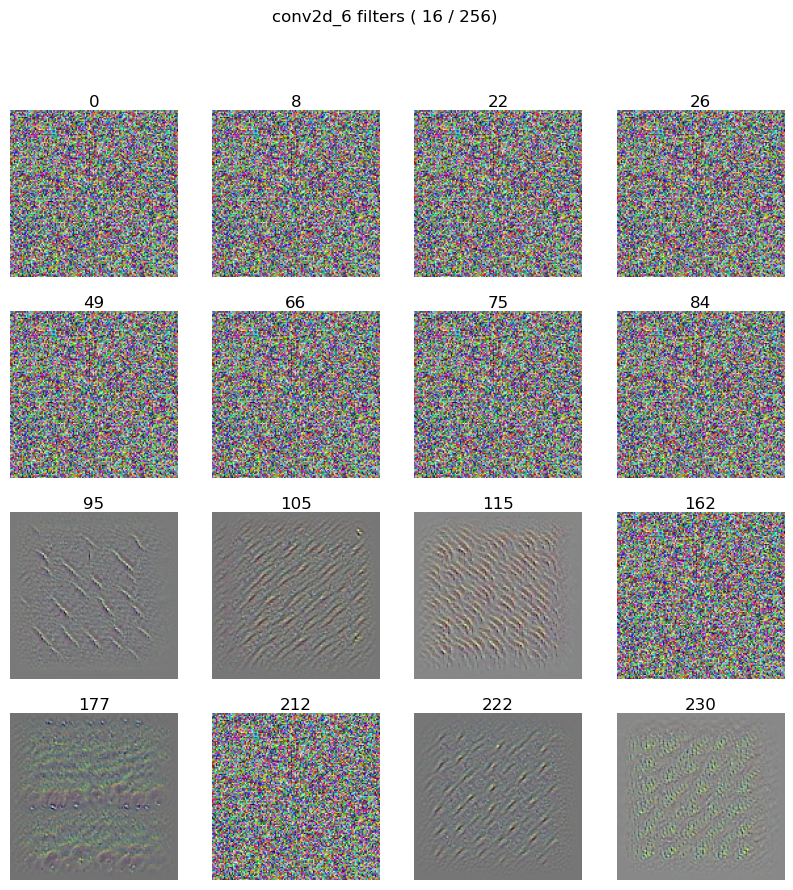

In [ ]:

layer_names = [layer.name for layer in cnn_model.layers if 'conv' in layer.name]
print(layer_names)
img = generate_random_image(shape = cnn_model.input_shape[1:], seed = None)
save_all_filters(input_img = img, layer_names = layer_names, 
                 model = cnn_model, n_filters = 16, 
                 epochs = 30, step = 10, save_dir = 'CNN'
                 )

In [ ]:
!zip -r VGG19_outputs.zip ./VGG19

  adding: VGG19/ (stored 0%)
  adding: VGG19/block1_conv2 filters.png (deflated 1%)
  adding: VGG19/block4_conv2 filters.png (deflated 0%)
  adding: VGG19/block3_conv4 filters.png (deflated 0%)
  adding: VGG19/block4_conv3 filters.png (deflated 0%)
  adding: VGG19/block4_conv1 filters.png (deflated 0%)
  adding: VGG19/block5_conv1 filters.png (deflated 0%)
  adding: VGG19/block1_conv1 filters.png (deflated 1%)
  adding: VGG19/block5_conv2 filters.png (deflated 1%)
  adding: VGG19/block4_conv4 filters.png (deflated 0%)
  adding: VGG19/block3_conv1 filters.png (deflated 0%)
  adding: VGG19/block3_conv2 filters.png (deflated 0%)
  adding: VGG19/block2_conv2 filters.png (deflated 1%)
  adding: VGG19/block2_conv1 filters.png (deflated 0%)
  adding: VGG19/block5_conv3 filters.png (deflated 1%)
  adding: VGG19/block5_conv4 filters.png (deflated 2%)
  adding: VGG19/block3_conv3 filters.png (deflated 0%)


In [ ]:
!zip -r CNN_outputs.zip ./CNN

  adding: CNN/ (stored 0%)
  adding: CNN/conv2d_3 filters.png (deflated 0%)
  adding: CNN/conv2d_4 filters.png (deflated 0%)
  adding: CNN/conv2d_5 filters.png (deflated 0%)
  adding: CNN/conv2d_6 filters.png (deflated 1%)
